In [ ]:
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tqdm import tqdm

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("puneet6060/intel-image-classification")

print("Path to dataset files:", path)

Path to dataset files: /root/.cache/kagglehub/datasets/puneet6060/intel-image-classification/versions/2


In [ ]:
path = "/root/.cache/kagglehub/datasets/puneet6060/intel-image-classification/versions/2"


In [ ]:
def load_data(datasets):

    output = []

    # Iterate through training and test sets
    for dataset in datasets:

        images = []
        labels = []

        print("Loading {}".format(dataset))

        # Iterate through each folder corresponding to a category
        for folder in os.listdir(dataset):
            label = class_names_label[folder]
            dataset_folder = (os.path.join(dataset, folder))
            # Iterate through each image in our folder
            for file in tqdm(os.listdir(dataset_folder)):

                # Get the path name of the image
                img_path = os.path.join(dataset_folder, file)

                # Open and resize the img
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, IMAGE_SIZE)

                # Append the image and its corresponding label to the output
                images.append(image)
                labels.append(label)

        images = np.array(images, dtype = 'float32')
        labels = np.array(labels, dtype = 'int32')

        output.append((images, labels))

    return output

In [ ]:
class_names = ['mountain', 'street', 'glacier', 'buildings', 'sea', 'forest']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}


nb_classes = len(class_names)

IMAGE_SIZE = (150, 150)

class_names_label

{'mountain': 0,
 'street': 1,
 'glacier': 2,
 'buildings': 3,
 'sea': 4,
 'forest': 5}

In [ ]:
datasets = [
    f"{path}/seg_train/seg_train",
    f"{path}/seg_test/seg_test"
]


In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data(datasets)


Loading /root/.cache/kagglehub/datasets/puneet6060/intel-image-classification/versions/2/seg_train/seg_train


100%|██████████| 2512/2512 [00:01<00:00, 2239.12it/s]


Loading /root/.cache/kagglehub/datasets/puneet6060/intel-image-classification/versions/2/seg_test/seg_test


100%|██████████| 525/525 [00:00<00:00, 2750.22it/s]


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

def stratified_sample(images, labels, sample_ratio=0.3):
    # Sử dụng stratified sampling để giữ phân bố đồng đều giữa các lớp
    sampled_images = []
    sampled_labels = []

    # Lặp qua các lớp (labels)
    for label in range(nb_classes):
        # Lấy chỉ số của các ảnh thuộc lớp 'label'
        class_indices = np.where(labels == label)[0]

        # Lấy 40% dữ liệu của lớp đó
        num_samples = int(len(class_indices) * sample_ratio)

        # Randomly select 40% of data from this class
        sampled_class_indices = np.random.choice(class_indices, num_samples, replace=False)

        # Append the sampled images and their labels
        sampled_images.extend(images[sampled_class_indices])
        sampled_labels.extend(labels[sampled_class_indices])

    # Chuyển kết quả thành numpy arrays
    sampled_images = np.array(sampled_images)
    sampled_labels = np.array(sampled_labels)

    return sampled_images, sampled_labels

# Sử dụng stratified sample cho dữ liệu huấn luyện và kiểm tra
train_images_sample, train_labels_sample = stratified_sample(train_images, train_labels, sample_ratio=0.3)
test_images_sample, test_labels_sample = stratified_sample(test_images, test_labels, sample_ratio=0.3)

print("Sampled train images shape:", train_images_sample.shape)
print("Sampled test images shape:", test_images_sample.shape)


Sampled train images shape: (4208, 150, 150, 3)
Sampled test images shape: (898, 150, 150, 3)


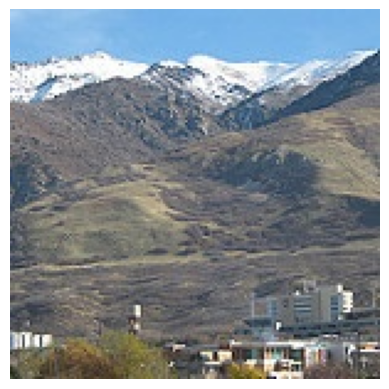

In [ ]:
 #Display the image stored in train_images[0] as an example
plt.imshow(train_images_sample[3].astype('uint8'))  # Ensure the data is in uint8 format for proper display (pictures saved as a np array of numirical values )
plt.axis('off')  # Hide axes (not needed for sjowing the picture)
plt.show()

In [ ]:
from sklearn.utils import shuffle

# Lấy mẫu đồng đều 40% từ dữ liệu huấn luyện
train_images_sample, train_labels_sample = stratified_sample(train_images, train_labels, sample_ratio=0.3)

# Shuffle lại dữ liệu sau khi đã lấy mẫu
train_images_sample, train_labels_sample = shuffle(train_images_sample, train_labels_sample, random_state=25)

# Lấy mẫu đồng đều 40% từ dữ liệu kiểm tra
test_images_sample, test_labels_sample = stratified_sample(test_images, test_labels, sample_ratio=0.3)

# Shuffle lại dữ liệu kiểm tra
test_images_sample, test_labels_sample = shuffle(test_images_sample, test_labels_sample, random_state=25)

print("Sampled and shuffled train images shape:", train_images_sample.shape)
print("Sampled and shuffled test images shape:", test_images_sample.shape)


Sampled and shuffled train images shape: (4208, 150, 150, 3)
Sampled and shuffled test images shape: (898, 150, 150, 3)


In [ ]:
# Sử dụng len() để lấy số lượng ví dụ trong tập huấn luyện và kiểm tra
n_train = len(train_labels_sample)  # Dữ liệu đã được lấy mẫu và shuffle
n_test = len(test_labels_sample)    # Dữ liệu đã được lấy mẫu và shuffle

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))
print("Each image is of size: {}".format(IMAGE_SIZE))


Number of training examples: 4208
Number of testing examples: 898
Each image is of size: (150, 150)


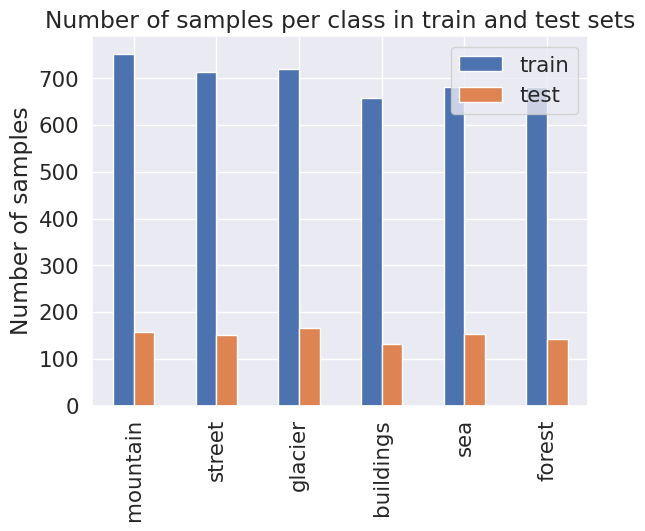

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Đảm bảo bạn đang sử dụng test_labels_sample và train_labels_sample
_, train_counts = np.unique(train_labels_sample, return_counts=True)
_, test_counts = np.unique(test_labels_sample, return_counts=True)

# Tạo DataFrame và vẽ biểu đồ cột
pd.DataFrame({'train': train_counts,
              'test': test_counts},
             index=class_names).plot.bar()

# Hiển thị biểu đồ
plt.title("Number of samples per class in train and test sets")
plt.ylabel("Number of samples")
plt.show()


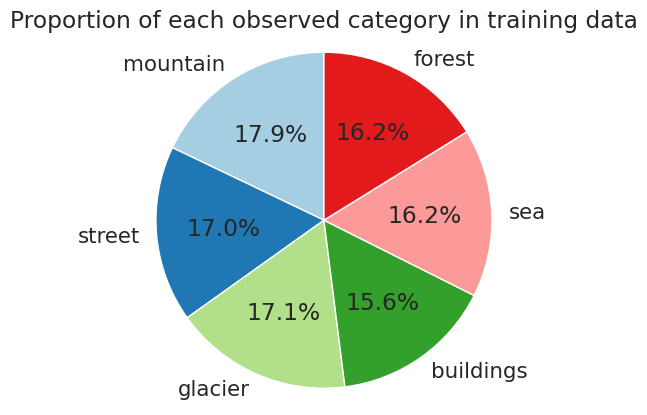

In [ ]:
import matplotlib.pyplot as plt

# Vẽ biểu đồ hình tròn cho tỷ lệ phần trăm của mỗi lớp trong tập huấn luyện
plt.pie(train_counts,
        explode=(0, 0, 0, 0, 0, 0),  # Không tách phần nào ra khỏi biểu đồ
        labels=class_names,          # Gán nhãn cho các lớp
        autopct='%1.1f%%',           # Hiển thị tỷ lệ phần trăm với 1 chữ số thập phân
        startangle=90,               # Bắt đầu từ góc 90 độ
        colors=plt.cm.Paired.colors) # Tùy chọn màu sắc cho các phần

# Giữ tỷ lệ hình tròn
plt.axis('equal')

# Thêm tiêu đề cho biểu đồ
plt.title('Proportion of each observed category in training data')

# Hiển thị biểu đồ
plt.show()


In [ ]:
# Chuẩn hóa (normalize) các giá trị pixel xuống [0, 1]
train_images_sample = train_images_sample / 255.0
test_images_sample = test_images_sample / 255.0

In [ ]:
def display_random_image(class_names, images, labels):
    """
        Display a random image from the images array and its correspond label from the labels array.
    """

    index = np.random.randint(images.shape[0])
    plt.figure()
    plt.imshow(images[index])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.title('Image #{} : '.format(index) + class_names[labels[index]])
    plt.show()



```
# Định dạng của đoạn này là mã
```



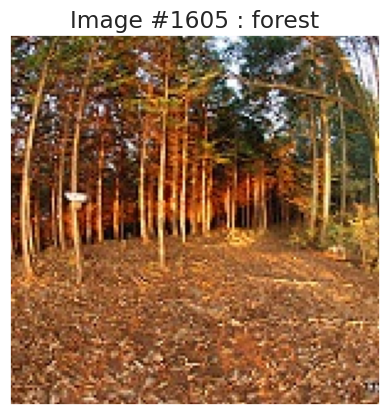

In [ ]:
display_random_image(class_names, train_images_sample, train_labels_sample)


In [ ]:
def display_examples(class_names, images, labels):
    """
        Display 25 images from the images array with its corresponding labels
    """

    fig = plt.figure(figsize=(10,10))
    fig.suptitle("Some examples of images of the dataset", fontsize=16)
    for i in range(25):
        plt.subplot(5,5,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(images[i], cmap=plt.cm.binary)
        plt.xlabel(class_names[labels[i]])
    plt.show()

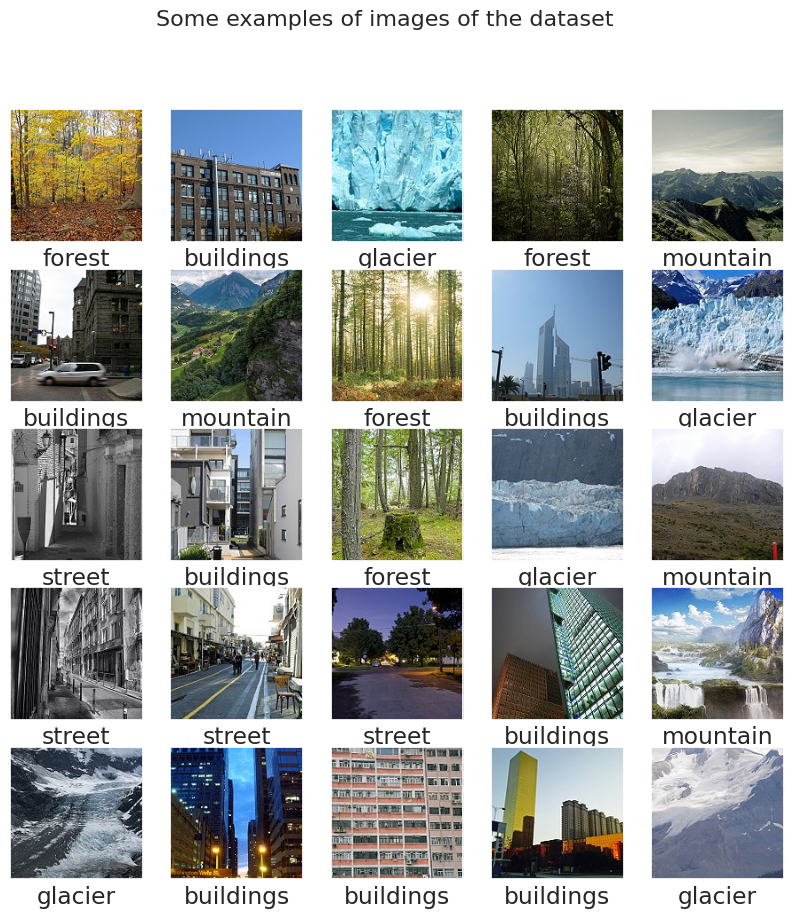

In [ ]:
display_examples(class_names, train_images_sample, train_labels_sample)


In [ ]:
import tensorflow as tf

# Xây dựng mô hình AlexNet
model = tf.keras.Sequential([
    # Lớp Conv1: 96 bộ lọc kích thước 11x11, stride 4
    tf.keras.layers.Conv2D(96, (11, 11), strides=4, activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=2),

    # Lớp Conv2: 256 bộ lọc kích thước 5x5
    tf.keras.layers.Conv2D(256, (5, 5), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=2),

    # Lớp Conv3: 384 bộ lọc kích thước 3x3
    tf.keras.layers.Conv2D(384, (3, 3), activation='relu', padding='same'),

    # Lớp Conv4: 384 bộ lọc kích thước 3x3
    tf.keras.layers.Conv2D(384, (3, 3), activation='relu', padding='same'),

    # Lớp Conv5: 256 bộ lọc kích thước 3x3
    tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=2),

    # Làm phẳng (Flatten) dữ liệu 2D thành 1D để đưa vào các lớp Dense
    tf.keras.layers.Flatten(),

    # Lớp Dense1: 4096 neuron, sử dụng ReLU
    tf.keras.layers.Dense(4096, activation='relu'),
    tf.keras.layers.Dropout(0.5),  # Dropout để giảm overfitting

    # Lớp Dense2: 4096 neuron, sử dụng ReLU
    tf.keras.layers.Dense(4096, activation='relu'),
    tf.keras.layers.Dropout(0.5),  # Dropout để giảm overfitting

    # Lớp Dense3: 6 neuron (cho bài toán phân loại 6 lớp)
    tf.keras.layers.Dense(6, activation='softmax')  # Sử dụng softmax cho phân loại đa lớp
])

# Compile mô hình
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Xem tổng quan mô hình
model.summary()

# Huấn luyện mô hình
history = model.fit(train_images_sample, train_labels_sample, batch_size=128, epochs=8, validation_split=0.2)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 35, 35, 96)          │          34,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 17, 17, 96)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 17, 17, 256)         │         614,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 8, 8, 384)           │         885,120 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 8, 8, 384)           │       1,327,488 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 8, 8, 256)           │         884,992 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 3, 3, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 2304)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 4096)                │       9,441,280 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 4096)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 4096)                │      16,781,312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 4096)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 6)                   │          24,582 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 29,994,374 (114.42 MB)

 Trainable params: 29,994,374 (114.42 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 293s 11s/step - accuracy: 0.1611 - loss: 2.2563 - val_accuracy: 0.1663 - val_loss: 1.7835
Epoch 2/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 344s 11s/step - accuracy: 0.2648 - loss: 1.7689 - val_accuracy: 0.2565 - val_loss: 1.7527
Epoch 3/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 337s 12s/step - accuracy: 0.3050 - loss: 1.7097 - val_accuracy: 0.3705 - val_loss: 1.5004
Epoch 4/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 400s 13s/step - accuracy: 0.4121 - loss: 1.4350 - val_accuracy: 0.4715 - val_loss: 1.3411
Epoch 5/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 323s 10s/step - accuracy: 0.5177 - loss: 1.2375 - val_accuracy: 0.5629 - val_loss: 1.1003
Epoch 6/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 375s 13s/step - accuracy: 0.5693 - loss: 1.1095 - val_accuracy: 0.5796 - val_loss: 1.0298
Epoch 7/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 353s 12s/step - accuracy: 0.5984 - loss: 1.0188 - val_accuracy: 0.6033 - val_loss: 0.9935
Epoch 8/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 278s 10s/step - accuracy: 0.6249 - loss: 0.9954 - val_accuracy: 0.5748 - v

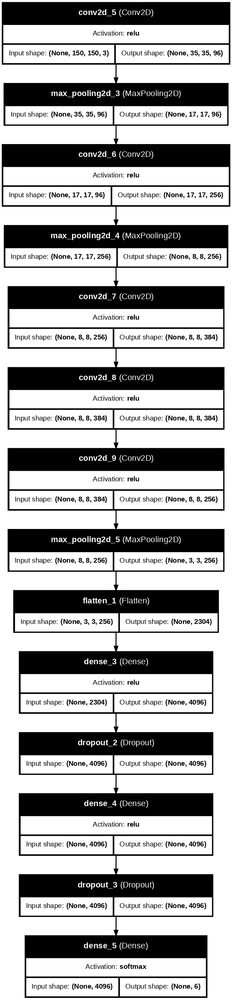

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file='alex_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=100
)

In [ ]:
import matplotlib.pyplot as plt

# Vẽ Training Accuracy vs. Epochs
plt.figure(figsize=(12, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy', linestyle='--')
plt.title('Training and Validation Accuracy vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# Vẽ Training/Validation Loss vs. Epochs
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='--')
plt.title('Training and Validation Loss vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

# Nếu bạn muốn vẽ Learning Rate, cần có callback theo dõi learning rate
# Sử dụng callback LearningRateScheduler hoặc ReduceLROnPlateau

# Giả sử bạn đã sử dụng LearningRateScheduler, bạn cần theo dõi và vẽ learning rate
# Đầu tiên, hãy tạo một list để lưu learning rate:
lr_history = history.history.get('lr', [])  # Nếu bạn đã sử dụng LearningRateScheduler

# Vẽ Learning Rate vs. Epochs
if lr_history:
    plt.figure(figsize=(12, 6))
    plt.plot(lr_history, label='Learning Rate')
    plt.title('Learning Rate vs Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Learning Rate')
    plt.legend()
    plt.grid(True)
    plt.show()


In [ ]:
test_loss, test_acc = model.evaluate(test_images_sample, test_labels_sample)
print('Test accuracy:', test_acc)

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 726ms/step - accuracy: 0.5820 - loss: 1.0427
Test accuracy: 0.5723830461502075


29/29 ━━━━━━━━━━━━━━━━━━━━ 18s 615ms/step


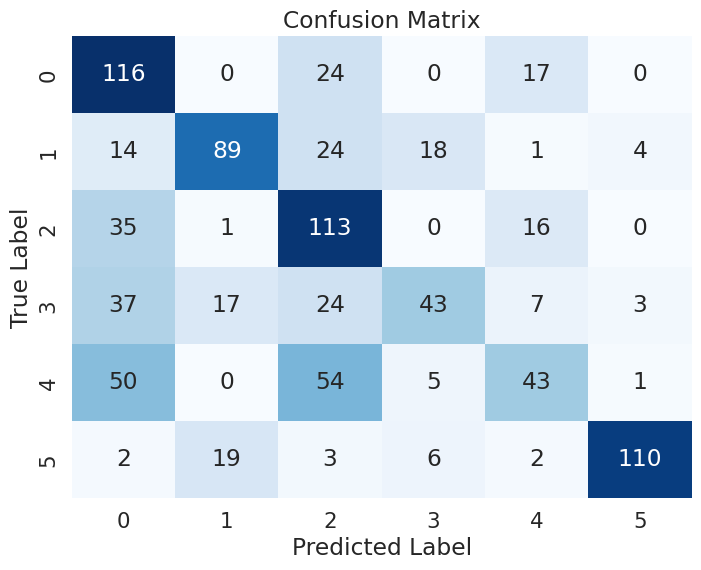

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

y_pred = model.predict(test_images_sample)
y_pred_classes = np.argmax(y_pred, axis=1)


cm = confusion_matrix(test_labels_sample, y_pred_classes)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=np.arange(6), yticklabels=np.arange(6), cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

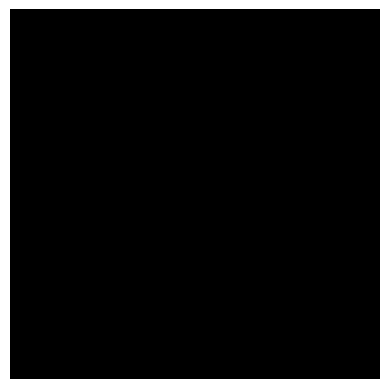

In [ ]:
# Display the image stored in train_images[0]
plt.imshow(train_images_sample[3].astype('uint8'))  # Ensure the data is in uint8 format for proper display
plt.axis('off')  # Optional: Hide axes
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


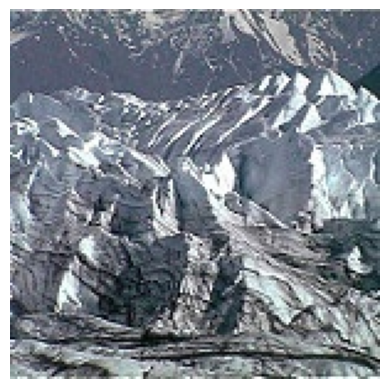

Predicted class: 2


In [ ]:
img1 = test_images_sample[2]

img1_batch = np.expand_dims(img1, axis=0)
img1_pred = model.predict(img1_batch)
img1 = test_images_sample[2]*255   # <<
plt.imshow(img1.astype('uint8'))
plt.axis('off')
plt.show()
print("Predicted class:", np.argmax(img1_pred))

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step


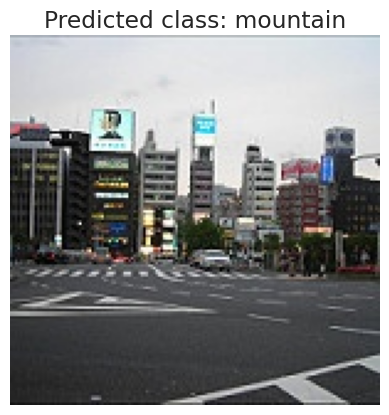

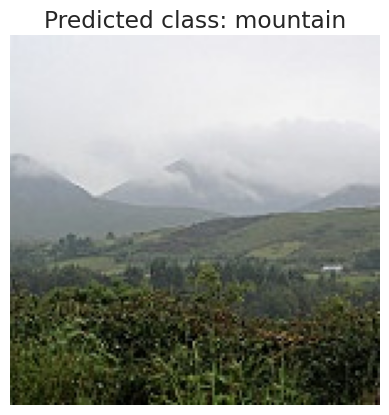

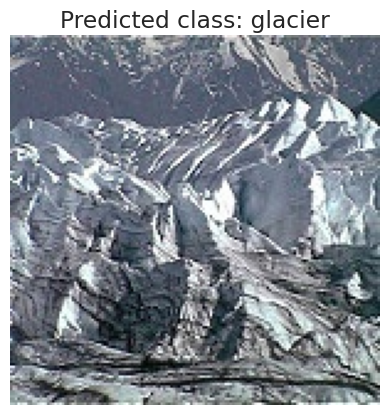

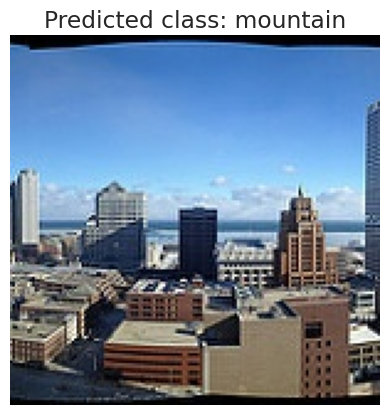

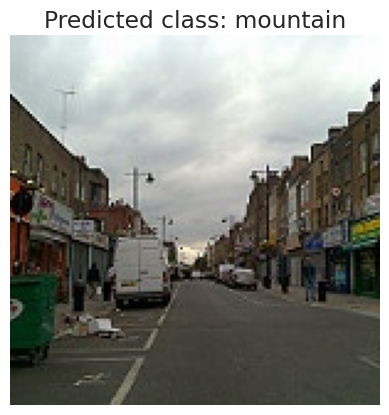

...

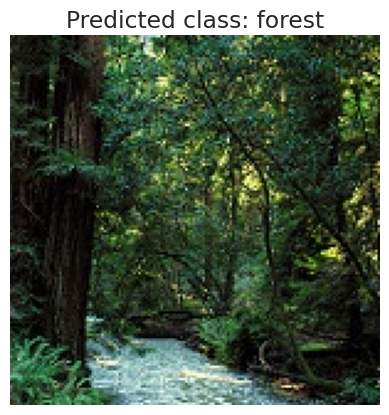

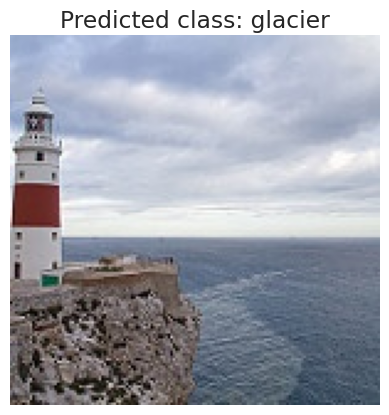

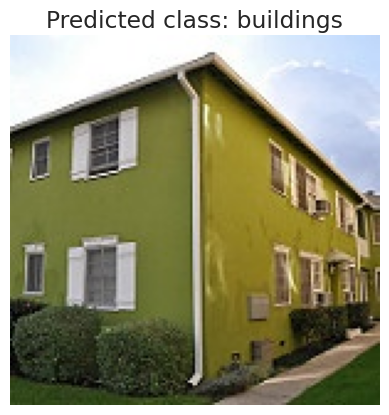

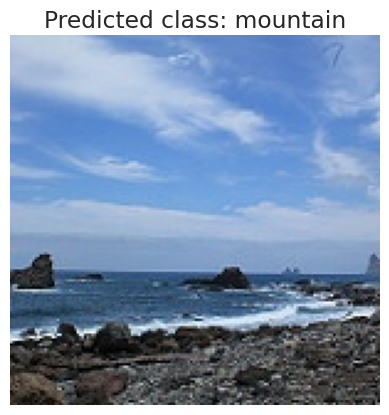

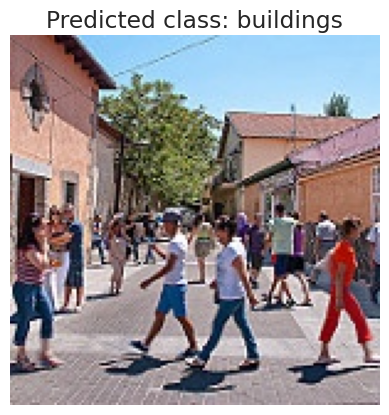

In [ ]:
# Lấy 5 ảnh đầu tiên từ test_images_sample
num_images = 20
images_to_predict = test_images_sample[:num_images]  # Lấy 5 ảnh đầu tiên

# Chuẩn bị batch ảnh để dự đoán (batch_size, height, width, channels)
images_batch = np.array(images_to_predict)  # Không cần expand_dims

# Dự đoán
predictions = model.predict(images_batch)

# Hiển thị ảnh và kết quả dự đoán
for i in range(num_images):
    img = images_to_predict[i] * 255  # Quy đổi ảnh về giá trị pixel gốc (nếu bạn đã chuẩn hóa ảnh)
    plt.imshow(img.astype('uint8'))
    plt.axis('off')
    plt.title(f"Predicted class: {class_names[np.argmax(predictions[i])]}")
    plt.show()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Lưu mô hình vào Google Drive
model.save('/content/drive/My Drive/alexnet_model.h5')


In [ ]:
from tensorflow.keras.applications import MobileNetV2

base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

base_model.trainable = False

x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)  # I used GlobalAveragePooling instead of Flatten (that reduce the overfit specially when dealing with smal dataset)
x = tf.keras.layers.Dropout(0.5)(x)

x = tf.keras.layers.Dense(128, activation='sigmoid')(x)
output = tf.keras.layers.Dense(6, activation='softmax')(x)

model_1 = tf.keras.Model(inputs=base_model.input, outputs=output)

model_1.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history_1 = model_1.fit(train_images_sample, train_labels_sample, batch_size=128, epochs=8, validation_split=0.2)

<ipython-input-33-94bf1dbbbab6>:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(150, 150, 3))


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 134s 5s/step - accuracy: 0.5501 - loss: 1.2512 - val_accuracy: 0.8777 - val_loss: 0.4043
Epoch 2/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 128s 5s/step - accuracy: 0.8423 - loss: 0.4568 - val_accuracy: 0.8872 - val_loss: 0.3380
Epoch 3/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 142s 5s/step - accuracy: 0.8652 - loss: 0.3634 - val_accuracy: 0.8919 - val_loss: 0.3110
Epoch 4/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 142s 5s/step - accuracy: 0.8796 - loss: 0.3217 - val_accuracy: 0.8884 - val_loss: 0.3054
Epoch 5/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 139s 5s/step - accuracy: 0.8924 - loss: 0.2980 - val_accuracy: 0.8967 - val_loss: 0.2939
Epoch 6/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 131s 5s/step - accuracy: 0.8977 - loss: 0.2927 - val_accuracy: 0.8955 - val_loss: 0.2888
Epoch 7/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 142s 5s/step - accuracy: 0.8988 - loss: 0.2820 - val_accuracy: 0.8943 - val_loss: 0.2950
Epoch 8/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 141s 5s/step - accuracy: 0.9123 

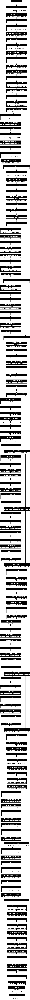

In [ ]:
tf.keras.utils.plot_model(
    model_1,
    to_file='Moiblenet_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=100
)

In [ ]:
test_loss_1, test_acc_1 = model_1.evaluate(test_images_sample, test_labels_sample)
print('Test accuracy:', test_acc_1)

29/29 ━━━━━━━━━━━━━━━━━━━━ 19s 644ms/step - accuracy: 0.9091 - loss: 0.2569
Test accuracy: 0.8930957913398743


29/29 ━━━━━━━━━━━━━━━━━━━━ 31s 983ms/step


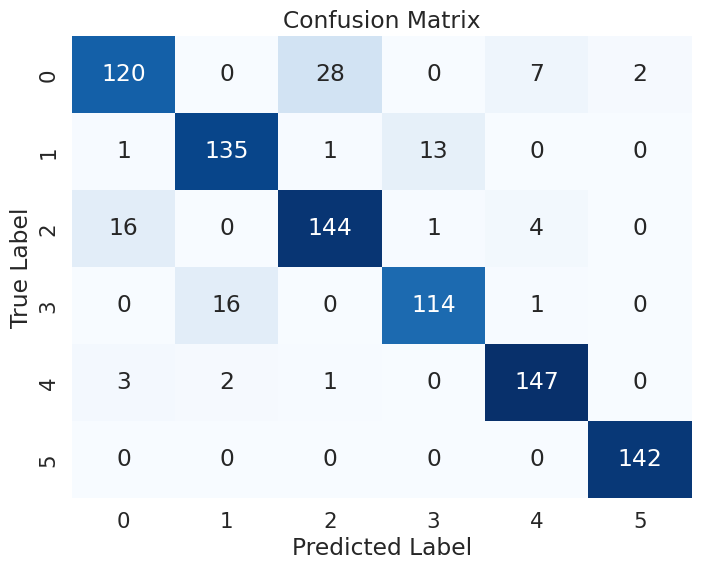

In [ ]:
y_pred_1 = model_1.predict(test_images_sample)
y_pred_classes_1 = np.argmax(y_pred_1, axis=1)


cm_1 = confusion_matrix(test_labels_sample, y_pred_classes_1)

plt.figure(figsize=(8, 6))
sns.heatmap(cm_1, annot=True, fmt='d', cmap='Blues', xticklabels=np.arange(6), yticklabels=np.arange(6), cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


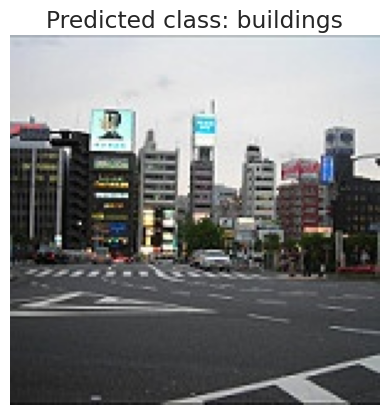

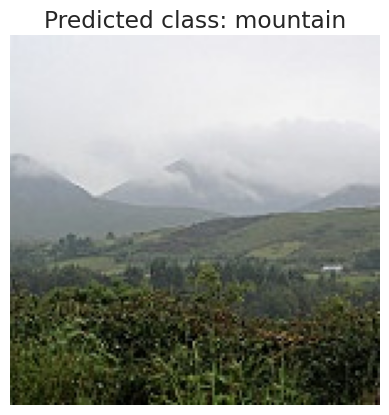

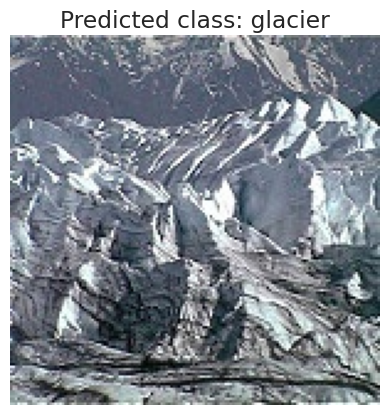

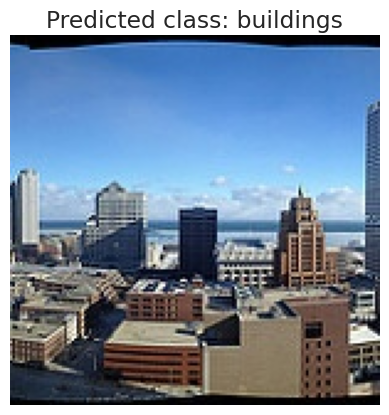

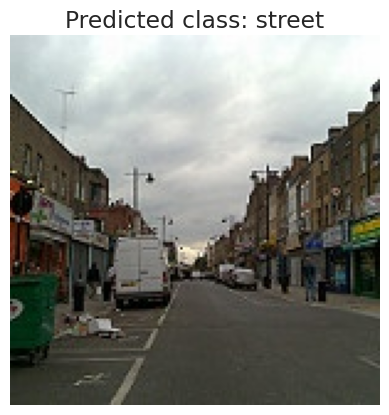

...

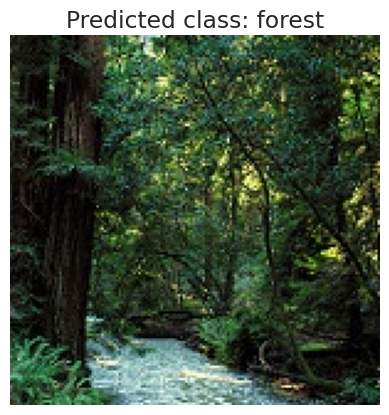

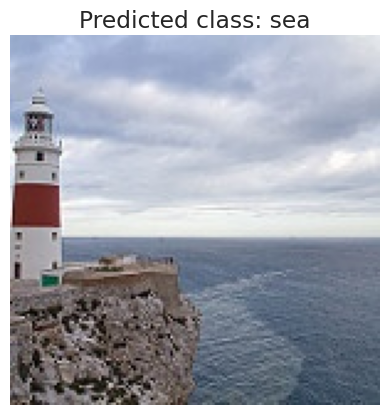

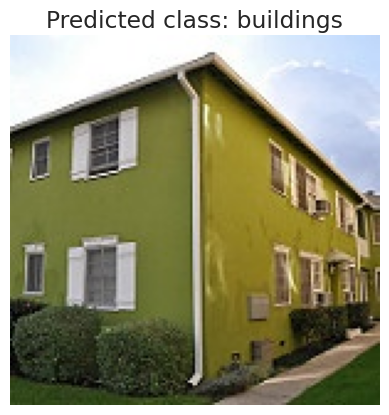

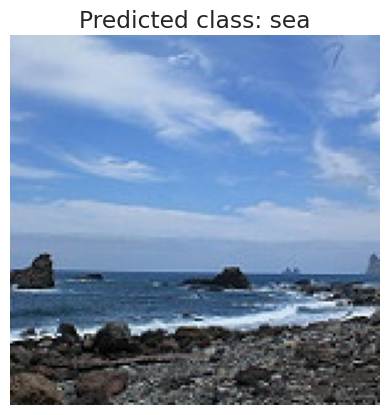

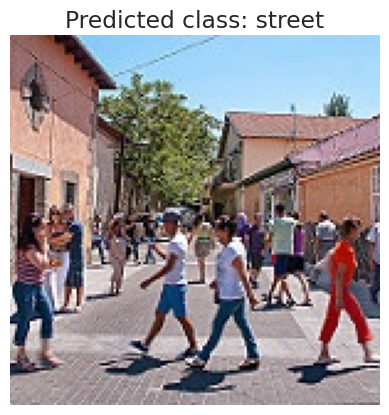

In [ ]:
# Lấy 5 ảnh đầu tiên từ test_images_sample
num_images = 20
images_to_predict = test_images_sample[:num_images]  # Lấy 5 ảnh đầu tiên

# Chuẩn bị batch ảnh để dự đoán (batch_size, height, width, channels)
images_batch = np.array(images_to_predict)  # Không cần expand_dims

# Dự đoán
predictions = model_1.predict(images_batch)

# Hiển thị ảnh và kết quả dự đoán
for i in range(num_images):
    img = images_to_predict[i] * 255  # Quy đổi ảnh về giá trị pixel gốc (nếu bạn đã chuẩn hóa ảnh)
    plt.imshow(img.astype('uint8'))
    plt.axis('off')
    plt.title(f"Predicted class: {class_names[np.argmax(predictions[i])]}")
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


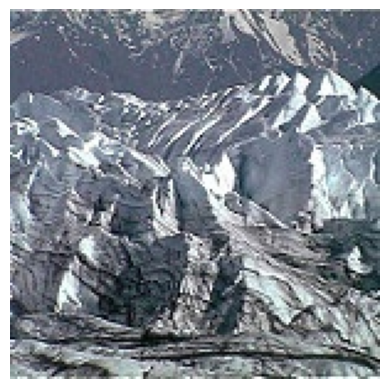

Predicted class: 2


In [ ]:
img2 = test_images_sample[2]

img2_batch = np.expand_dims(img2, axis=0)
img2_pred = model_1.predict(img2_batch)
img2 = test_images_sample[2]*255   # <<
plt.imshow(img2.astype('uint8'))
plt.axis('off')
plt.show()
print("Predicted class:", np.argmax(img2_pred))

In [ ]:
# Lưu mô hình vào Google Drive
model_1.save('/content/drive/My Drive/moibileNet_model.h5')

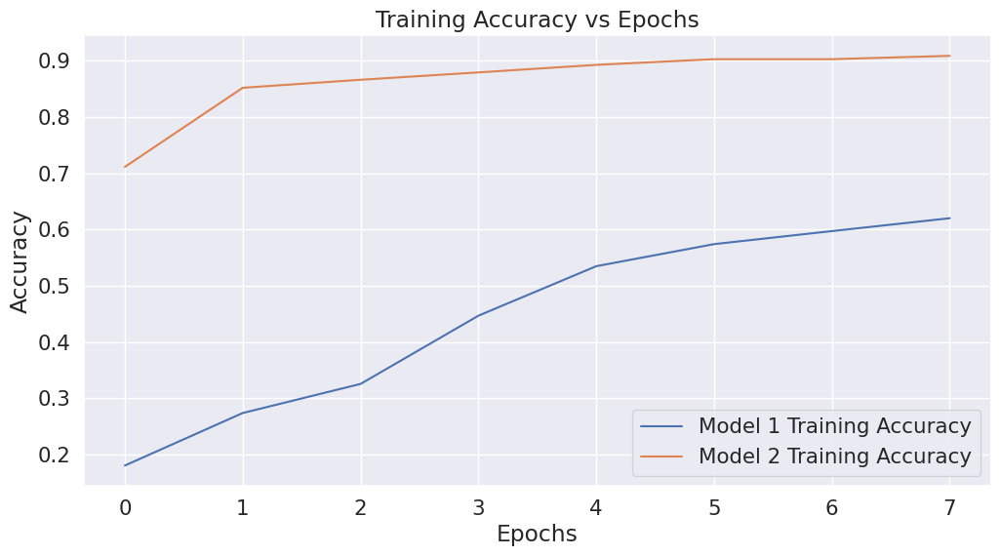

In [ ]:
# Vẽ Training Accuracy
plt.figure(figsize=(12, 6))
plt.plot(history.history['accuracy'], label='Model 1 Training Accuracy')
plt.plot(history_1.history['accuracy'], label='Model 2 Training Accuracy')
plt.title('Training Accuracy vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


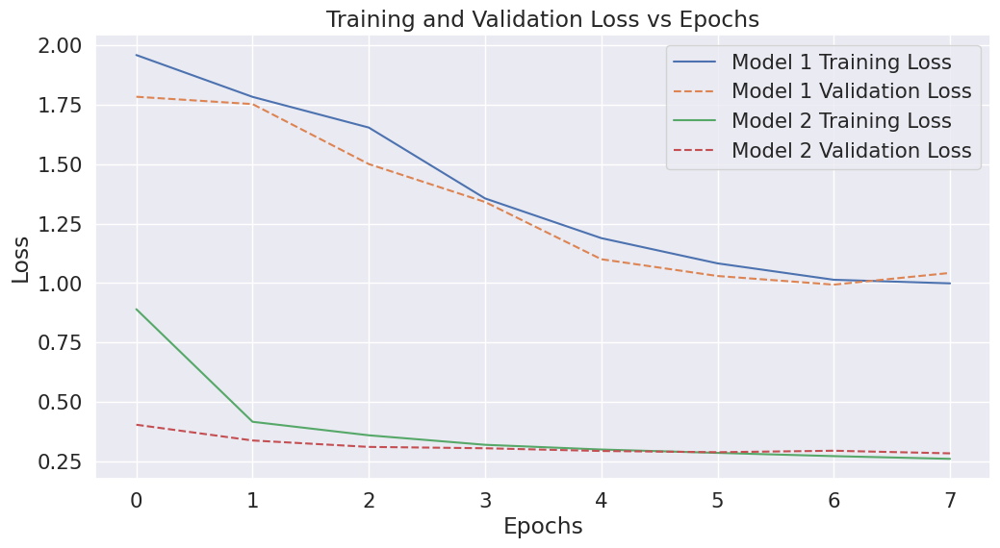

In [ ]:
# Vẽ Training and Validation Loss
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Model 1 Training Loss')
plt.plot(history.history['val_loss'], label='Model 1 Validation Loss', linestyle='--')

plt.plot(history_1.history['loss'], label='Model 2 Training Loss')
plt.plot(history_1.history['val_loss'], label='Model 2 Validation Loss', linestyle='--')


plt.title('Training and Validation Loss vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
from tensorflow.keras.applications import ResNet50
import tensorflow as tf

# Sử dụng ResNet50 làm base model
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

# Giữ nguyên các trọng số của base model
base_model.trainable = False

# Xây dựng phần tiếp theo của mô hình
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)  # GlobalAveragePooling giảm overfitting
x = tf.keras.layers.Dropout(0.5)(x)              # Dropout để giảm overfitting

x = tf.keras.layers.Dense(128, activation='sigmoid')(x)
output = tf.keras.layers.Dense(6, activation='softmax')(x)  # 6 classes

# Tạo mô hình mới với base model là ResNet50
model_2 = tf.keras.Model(inputs=base_model.input, outputs=output)

# Biên dịch mô hình
model_2.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Huấn luyện mô hình
history_2 = model_2.fit(train_images_sample, train_labels_sample, batch_size=128, epochs=8, validation_split=0.2)


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 512s 19s/step - accuracy: 0.1655 - loss: 1.8499 - val_accuracy: 0.3076 - val_loss: 1.7587
Epoch 2/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 560s 19s/step - accuracy: 0.2365 - loss: 1.7553 - val_accuracy: 0.4216 - val_loss: 1.7057
Epoch 3/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 493s 18s/step - accuracy: 0.2745 - loss: 1.7102 - val_accuracy: 0.4097 - val_loss: 1.6794
Epoch 4/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 505s 19s/step - accuracy: 0.2948 - loss: 1.6911 - val_accuracy: 0.3872 - val_loss: 1.6391
Epoch 5/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 445s 16s/step - accuracy: 0.3221 - loss: 1.6596 - val_accuracy: 0.4347 - val_loss: 1.6060
Epoch 6/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 502s 19s/step - accuracy: 0.3648 - loss: 1.6207 - val_accuracy: 0.3789 - val_loss: 1.5718
Epoch 7/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 445s 17s/step - accuracy: 0.3533 - loss: 1.5969 - val_accuracy: 0.3967 - val_loss: 1.5525
Epoch 8/8
27/27 ━━━━━━━━━━━━━━━━━━━━ 553s 19s/step - accurac

In [ ]:
test_loss_2, test_acc_2 = model_2.evaluate(test_images_sample, test_labels_sample)
print('Test accuracy:', test_acc_2)

29/29 ━━━━━━━━━━━━━━━━━━━━ 88s 3s/step - accuracy: 0.4598 - loss: 1.5029
Test accuracy: 0.4309576749801636


29/29 ━━━━━━━━━━━━━━━━━━━━ 126s 4s/step


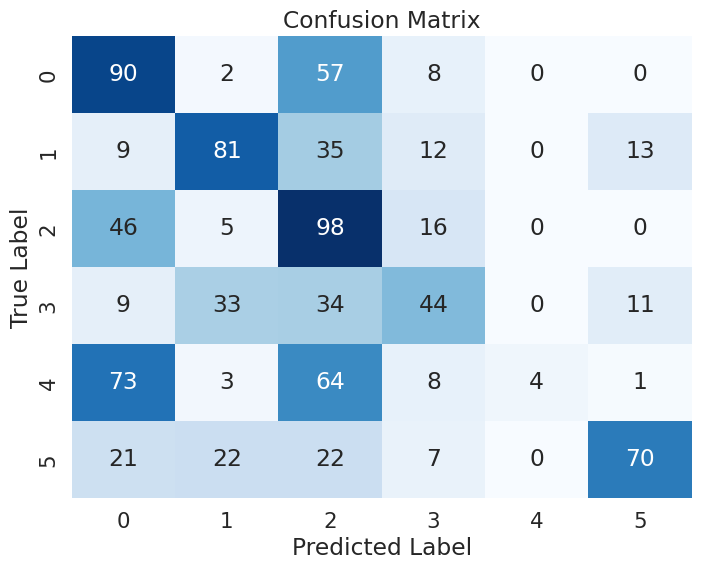

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

y_pred_2 = model_2.predict(test_images_sample)
y_pred_classes_2 = np.argmax(y_pred_2, axis=1)


cm_2 = confusion_matrix(test_labels_sample, y_pred_classes_2)

plt.figure(figsize=(8, 6))
sns.heatmap(cm_2, annot=True, fmt='d', cmap='Blues', xticklabels=np.arange(6), yticklabels=np.arange(6), cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


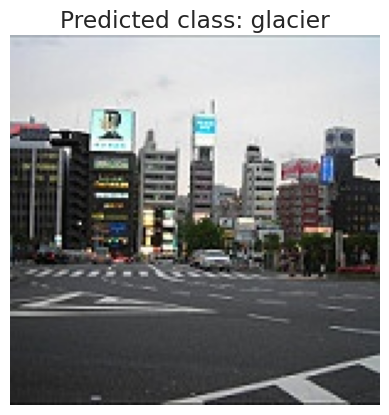

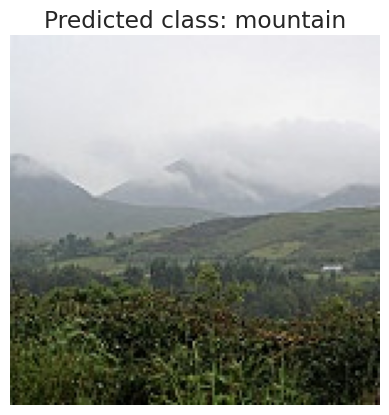

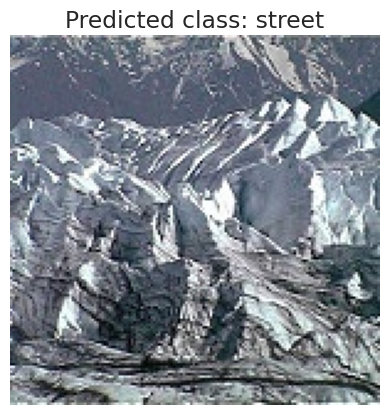

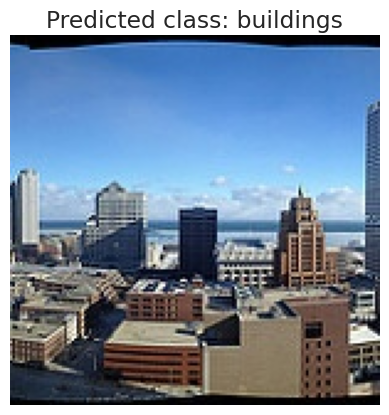

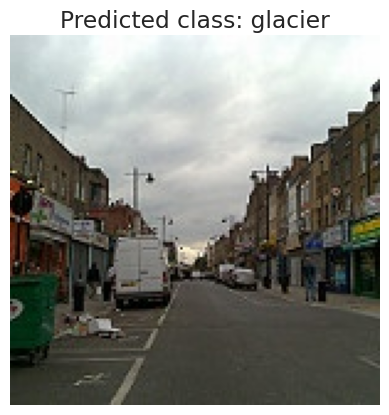

...

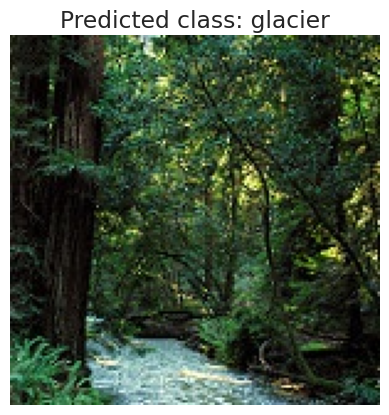

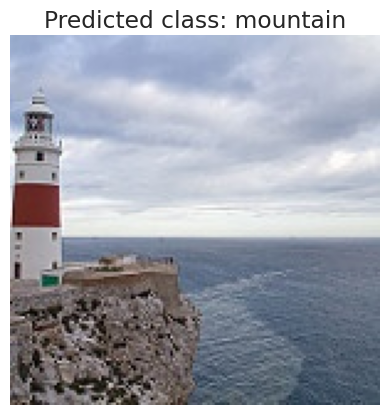

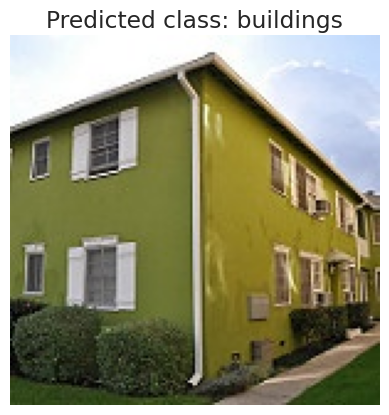

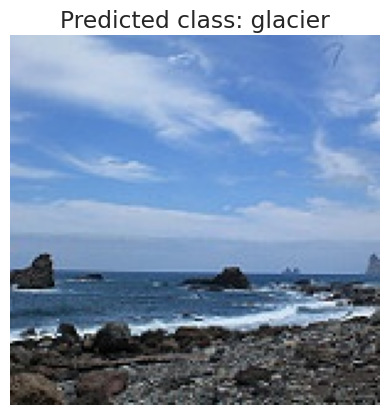

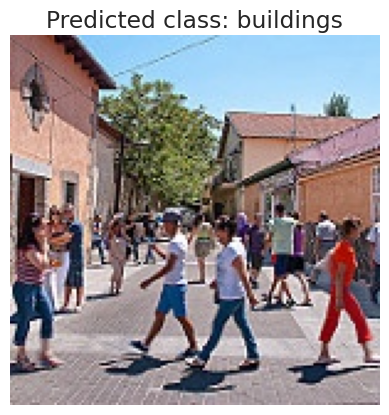

In [ ]:
# Lấy 5 ảnh đầu tiên từ test_images_sample
num_images = 20
images_to_predict = test_images_sample[:num_images]  # Lấy 5 ảnh đầu tiên

# Chuẩn bị batch ảnh để dự đoán (batch_size, height, width, channels)
images_batch = np.array(images_to_predict)  # Không cần expand_dims

# Dự đoán
predictions = model_2.predict(images_batch)

# Hiển thị ảnh và kết quả dự đoán
for i in range(num_images):
    img = images_to_predict[i] * 255  # Quy đổi ảnh về giá trị pixel gốc (nếu bạn đã chuẩn hóa ảnh)
    plt.imshow(img.astype('uint8'))
    plt.axis('off')
    plt.title(f"Predicted class: {class_names[np.argmax(predictions[i])]}")
    plt.show()


In [ ]:
# Lưu mô hình vào Google Drive
model_2.save('/content/drive/My Drive/Resnet50_model.h5')

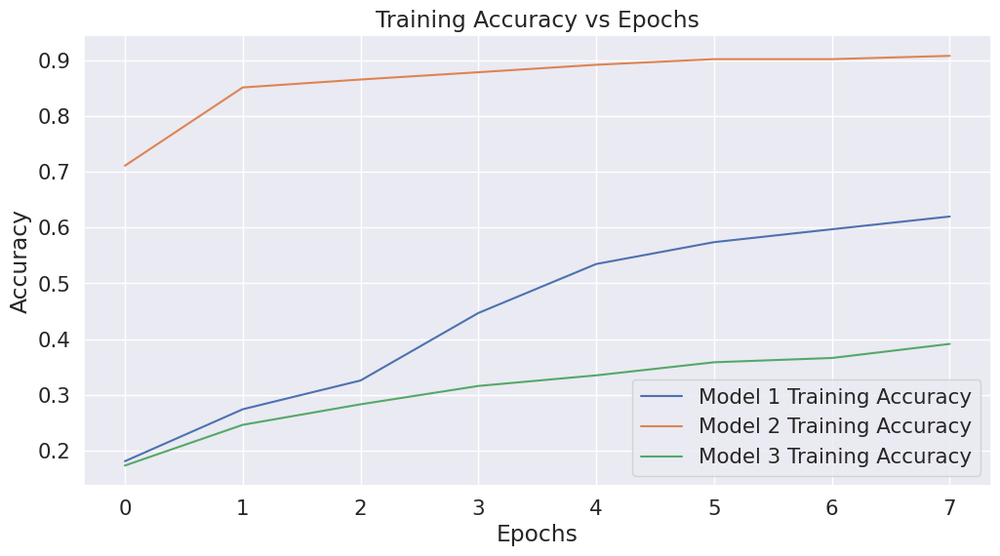

In [ ]:
# Vẽ Training Accuracy
plt.figure(figsize=(12, 6))
plt.plot(history.history['accuracy'], label='Model 1 Training Accuracy')
plt.plot(history_1.history['accuracy'], label='Model 2 Training Accuracy')
plt.plot(history_2.history['accuracy'], label='Model 3 Training Accuracy')

plt.title('Training Accuracy vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


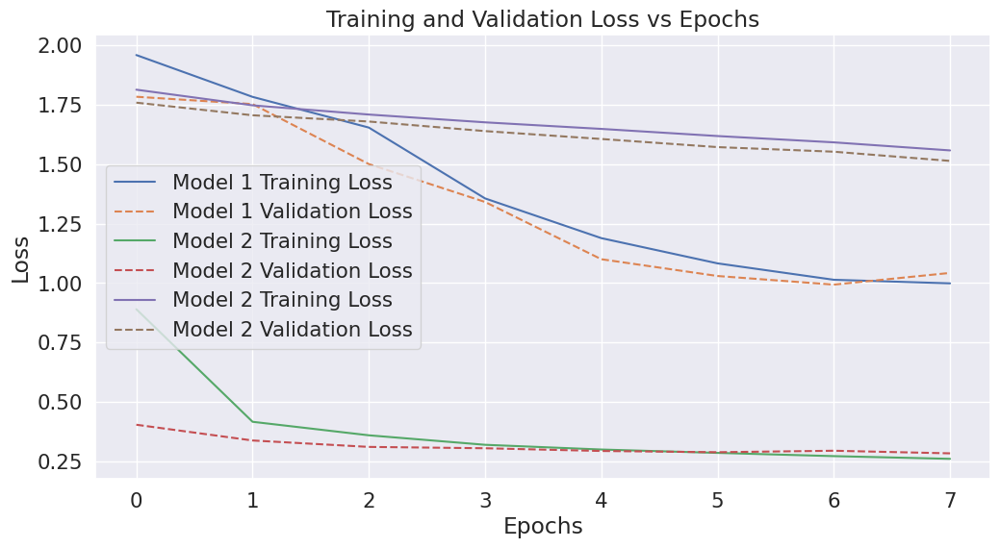

In [ ]:
# Vẽ Training and Validation Loss
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Model 1 Training Loss')
plt.plot(history.history['val_loss'], label='Model 1 Validation Loss', linestyle='--')

plt.plot(history_1.history['loss'], label='Model 2 Training Loss')
plt.plot(history_1.history['val_loss'], label='Model 2 Validation Loss', linestyle='--')

plt.plot(history_2.history['loss'], label='Model 2 Training Loss')
plt.plot(history_2.history['val_loss'], label='Model 2 Validation Loss', linestyle='--')


plt.title('Training and Validation Loss vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()
